In [1]:
from array import array

import numpy as np
import torch
from sklearn.utils import shuffle

from src.args import Args
from src.networks import VAE
from src.networks.maga_net import MAGANet
from src.registry import setup
from src.common.utils import set_seed
from src.dataset import DspritesDataset, get_dataloaders_2element

import matplotlib.pyplot as plt
# from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE
import umap
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
from sklearn.decomposition import PCA

import plotly.graph_objects as go

In [3]:
def encode_img(train_loader, test_loader, model, args):
    model.eval()  # Set model to evaluation mode

    latent_vir = []

    single_output = args.model_name == "vae"
    if single_output:
        for batch_idx, x1 in enumerate(test_loader):
            x1 = x1.to(args.device)  # Move tensors to GPU if available
            x, mu, logvar = model(x1)  # Forward pass
            z = model.reparameterize(mu, logvar)
            latent_vir.append(z.detach().cpu().numpy())

        for batch_idx, x1 in enumerate(train_loader):
            x1 = x1.to(args.device)  # Move tensors to GPU if available
            x, mu, logvar = model(x1)  # Forward pass
            z = model.reparameterize(mu, logvar)
            latent_vir.append(z.detach().cpu().numpy())
    else:
        for batch_idx, (x1, x2) in enumerate(test_loader):
            x1, x2 = x1.to(args.device), x2.to(args.device)  # Move tensors to GPU if available
            z, mu1, logvar1, mu2, logvar2, decoded_x1, decoded_x2  = model(x1, x2)  # Forward pass
            latent_vir.append(z.detach().cpu().numpy())

        for batch_idx, (x1, x2) in enumerate(train_loader):
            x1, x2 = x1.to(args.device), x2.to(args.device)  # Move tensors to GPU if available
            z, mu1, logvar1, mu2, logvar2, decoded_x1, decoded_x2  = model(x1, x2)  # Forward pass
            latent_vir.append(z.detach().cpu().numpy())

    z = np.vstack(latent_vir)
    np.save("../outputs/latent_vir", z)
    print("result saved")
    return

In [4]:
def generate_files(path):
    args = Args(file=f"{path}/hyperparameters.yaml")

    single_output = args.model_name == "vae"
    train_data = DspritesDataset("../data/2d/train.npz", single_output=single_output)
    test_data = DspritesDataset("../data/2d/test.npz", single_output=single_output)

    z_gt = np.concatenate([test_data.latents_values,train_data.latents_values])
    np.save("../outputs/latent_vir_gt", z_gt)
    print("ground truth latent value saved")

    train_loader, test_loader = get_dataloaders_2element(
        train_data, test_data,
        batch_size=args.batch_size,
        shuffle=False
    )

    if args.model_name == "maga":
        model = MAGANet(args)
        model.load_state_dict(torch.load(
            f"{path}/models/model_2element.pth"))
        model = model.to(args.device)
    elif args.model_name == "vae":
        model = VAE(args)
        model.load_state_dict(torch.load(
            f"{path}/models/model_2element.pth"))
        model = model.to(args.device)


    encode_img(train_loader, test_loader, model, args)
    return 

## Generate files

In [5]:
# generate_files("../outputs/run_dev_maga/seed_2_250320250829")
generate_files("../outputs/run_dev_vae/seed_2_250320251556")

ground truth latent value saved
result saved


In [10]:
z = np.load("../outputs/latent_vir.npy")
# z = np.load("./outputs/latent_vir_2range.npy")
z_gt = np.load("../outputs/latent_vir_gt.npy")

print(z.shape)

(737280, 10)


## Use UMAP for visualization

### 2D example

/home/amzi/Documents/DSAIT4125/dsait4125-cv/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


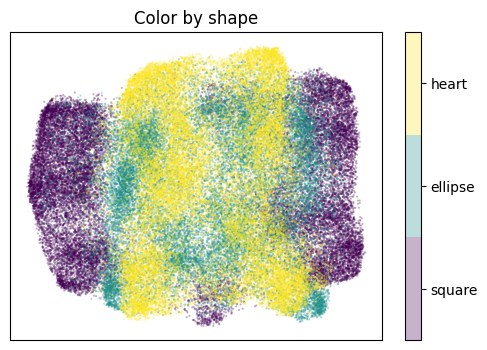

In [7]:
## see shape
classes = ['square', 'ellipse', 'heart']
z1 = z[0:-1:10]
z_gt1 = z_gt[0:-1:10][:, 1].reshape(-1)  # shape
z_embedded = umap.UMAP(n_neighbors=50).fit_transform(z1)

fig, ax = plt.subplots(1, figsize=(6, 4))
plt.scatter(*z_embedded.T, s=0.3, c=z_gt1-1, alpha=0.3)
plt.setp(ax, xticks=[], yticks=[])
cbar = plt.colorbar(boundaries=np.arange(4) - 0.5, spacing='uniform')
cbar.set_ticks(np.array([0,1,2]))
cbar.set_ticklabels(classes)
plt.title("Color by shape")
plt.show()

### 3D visualization

#### shape

In [42]:
classes = ['square', 'ellipse', 'heart']
z1 = z[0:-1:10]
z_gt1 = z_gt[0:-1:10][:, 1].reshape(-1)

# Apply UMAP with 3 components for 3D visualization
z_embedded = umap.UMAP(n_neighbors=50, n_components=3).fit_transform(z1)

import matplotlib.cm as cm
# Create a discrete viridis colormap
discrete_colors = cm.viridis(np.linspace(0, 1, len(classes)))
discrete_colors_hex = [f'rgb({int(r*255)},{int(g*255)},{int(b*255)})' for r,g,b,_ in discrete_colors]

# Create 3D scatter plot
fig = go.Figure()

# Prepare data for each class separately
traces = []
for class_idx in range(len(classes)):
    # Filter points for this specific class
    class_mask = (z_gt1 == class_idx + 1)
    
    traces.append(go.Scatter3d(
        x=z_embedded[class_mask, 0],
        y=z_embedded[class_mask, 1],
        z=z_embedded[class_mask, 2],
        mode='markers',
        name=classes[class_idx],
        marker=dict(
            size=2,
            color=discrete_colors_hex[class_idx],
            opacity=0.5
        ),
        text=[classes[class_idx]] * sum(class_mask),
        hoverinfo='text'
    ))

# Add all traces to the figure
fig.add_traces(traces)

# Customize layout
fig.update_layout(
    title={
        'text': "Color by Shape",
        'y':0.8,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    scene=dict(
        # bgcolor="white",
        xaxis_title="",
        yaxis_title="",
        zaxis_title=""
    ),
    width=600,
    height=600,
    margin=dict(r=50),
    legend=dict(
        font=dict(size=14),  # Increase legend text size
        itemsizing='constant',  # Keep legend marker size consistent
        itemwidth=30  # Increase width of legend items
    )
)

fig.show()

/home/amzi/Documents/DSAIT4125/dsait4125-cv/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



#### position

In [49]:
## see position
z_gt1 = z_gt[0:-1:10][:, -2].reshape(-1) #pos_x

# Create 3D scatter plot
fig = go.Figure()

# Add scatter plot with continuous color mapping
scatter = go.Scatter3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    mode='markers',
    marker=dict(
        size=2,  # Larger marker size
        color=z_gt1,  # Color based on pos_x
        colorscale='viridis',  # Viridis colormap
        opacity=0.7,  # Slightly increased opacity
        colorbar=dict(
            title='pos_x',
            len=0.8,  # Length of colorbar
            thickness=30,  # Thickness of colorbar
            xanchor='right',
            x=1.1  # Position colorbar slightly to the right
        ),
        showscale=True
    ),
    hovertemplate='pos_x: %{marker.color:.2f}<extra></extra>'
)

fig.add_trace(scatter)

# Customize layout
fig.update_layout(
    title={
        'text': "Color by pos_x",
        'y':0.8,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    scene=dict(
        # bgcolor="white",
        xaxis_title="",
        yaxis_title="",
        zaxis_title=""
    ),
    width=600,
    height=600,
    margin=dict(r=50)  # Extra margin for colorbar
)

fig.show()

In [50]:
## see position
z_gt1 = z_gt[0:-1:10][:, -1].reshape(-1)  #pos_y

# Create 3D scatter plot
fig = go.Figure()

# Add scatter plot with continuous color mapping
scatter = go.Scatter3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    mode='markers',
    marker=dict(
        size=2,  # Larger marker size
        color=z_gt1,  # Color based on pos_x
        colorscale='viridis',  # Viridis colormap
        opacity=0.7,  # Slightly increased opacity
        colorbar=dict(
            title='pos_y',
            len=0.8,  # Length of colorbar
            thickness=30,  # Thickness of colorbar
            xanchor='right',
            x=1.1  # Position colorbar slightly to the right
        ),
        showscale=True
    ),
    hovertemplate='pos_y: %{marker.color:.2f}<extra></extra>'
)

fig.add_trace(scatter)

# Customize layout
fig.update_layout(
    title={
        'text': "Color by pos_y",
        'y':0.8,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    scene=dict(
        # bgcolor="white",
        xaxis_title="",
        yaxis_title="",
        zaxis_title=""
    ),
    width=600,
    height=600,
    margin=dict(r=50)  # Extra margin for colorbar
)

fig.show()

#### scale

In [56]:
## see scale
rotation = z_gt[0:-1:10][:, 3].reshape(-1)
pos_x = z_gt[0:-1:10][:, -2].reshape(-1)
mask = (np.isclose(rotation, 0.001, atol=1e-2))

z_gt1 = z_gt[0:-1:10][:, 2].reshape(-1)  #scale

z_gt2 = z_gt1[mask]
z_embedded1=z_embedded[mask]
fig = px.scatter_3d(
    x=z_embedded1[:, 0],
    y=z_embedded1[:, 1],
    z=z_embedded1[:, 2],
    color=z_gt2,
    opacity=0.5,
    color_continuous_scale='viridis',
    labels={'color': 'Shape'},
    title='Color by pox_y'
)

fig.show()

In [29]:
## see rotation
z_gt1 = z_gt[0:-1:10][:, 3].reshape(-1)  #orientation
fig = px.scatter_3d(
    x=z_embedded[:, 0],
    y=z_embedded[:, 1],
    z=z_embedded[:, 2],
    color=z_gt1,
    opacity=0.5,
    color_continuous_scale='hsv',
    labels={'color': 'Shape'},
    title='Color by pox_y'
)

fig.show()